### DCGAN 

In this notebook we are going to follow [this](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html) tutorial from pytorch to implement a dcgan that was implemented from [pytorch-examples](https://github.com/pytorch/examples)


### What is a GAN?

**G**enarative **A**dvesarial **N**etworks (GANS) are type of networks invernted by Ian Goodfellow in 2014 decribed in the deep learning paper [ Generative Adversarial Nets](https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf). GANs captures the features of the train data so that we can generate data from the same distribution.

A Gan contains two distinct models trained to compete each other _Generator_ and _Discriminator_.

1. Generator

The job of the generator is to fool the discriminator by generating fake images that looks like the images in the train set. During training the generator is trying to generate images from that looks like the one that are in the train examples to fool the discriminator. The more we train the generator the better it becomes and the more it generate images which looks like the ones we have trained on. 

2. Discriminator

The task of the discriminator is to tell weather the images generated by the generator are real or fake. The discriminator is working to become a better detective and correctly classify the real and fake images. 

> The equilibrium of this game is when the generator is generating perfect fakes that look as if they came directly from the training data, and the discriminator is left to always guess at 50% confidence that the generator output is real or fake.


### What gans do?
Gans generate images or fake data from the distributions they are trained on. You can not generate images of watermelons if you train your gan on the dataset that contains images of human faces.

### Definition

Let $x$ be a represantaion of an image and $D(x)$ be the discriminator model which is basically an image classifier network that output the probability of a generated image to be real or fake.

For the generator $G(z)$ where $z$ will be a lated space vector of a standard normal distribution.

So, $D(G(z))$ is the probability (scalar) that the output of the
generator $G$ is a real image. As described in [Goodfellow’s
paper](https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf),
$D$ and $G$ play a minimax game in which $D$ tries to
maximize the probability it correctly classifies reals and fakes
($logD(x)$), and $G$ tries to minimize the probability that
$D$ will predict its outputs are fake ($log(1-D(G(z)))$).
From the paper, the GAN loss function is

\begin{align}\underset{G}{\text{min}} \underset{D}{\text{max}}V(D,G) = \mathbb{E}_{x\sim p_{data}(x)}\big[logD(x)\big] + \mathbb{E}_{z\sim p_{z}(z)}\big[log(1-D(G(z)))\big]\end{align}

### What is a DCGAN then?
A DCGAN is a direct extenstion of a GAN describe above, except that it explicitly uses convulutional and convulutional transpose layers in the discriminator and generator respectively. It was first described by Radford et. al. in the paper [Unsupervised Representation Learning With Deep Convolutional Generative Adversarial Networks](https://arxiv.org/pdf/1511.06434.pdf). The discriminator is made up of strided convolution layers, batch norm layers, and [LeakyReLU](https://pytorch.org/docs/stable/nn.html#torch.nn.LeakyReLU) activations. 

The input is a ``3x64x64`` input image and the output is a scalar probability that the input is from the real data distribution.

The generator is comprised of [convolutional-transpose](https://pytorch.org/docs/stable/nn.html#torch.nn.ConvTranspose2d) layers, batch norm layers, and [ReLU](https://pytorch.org/docs/stable/nn.html#relu) activations.

 The input is a latent vector, $z$, that is drawn from a standard normal distribution and the output is a ``3x64x64`` RGB image. The strided conv-transpose layers allow the latent vector to be transformed into a volume with the same shape as an image. 


In [1]:
import os
import random
import torch
import numpy as np
import matplotlib.pyplot as plt

from torchvision import datasets, transforms
from torch import nn

torch.__version__

'1.10.0+cu111'

### Device
Get GPU accelleration if possible

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

### Seed

Setting the ``seed`` for reproducibility.

In [3]:
SEED = 42

np.random.seed(SEED)
random.seed(SEED)
torch.manual_seed(SEED)

print("....")

....


### Defining some variables

For varibales like `lr` we are going to use the ones that were decribed in the paper and will be defined in the following code cell.

In [4]:
dataroot = "/content/drive/My Drive/img_align_celeba"

BATCH_SIZE = 128
IMG_SIZE = 64
LATENT_DIM = 100

LR = 0.0002
BETA = 0.5

N_WORKERS = 2

### Data

In this notebook we are going to use the [Celeb-A Faces dataset](https://www.kaggle.com/jessicali9530/celeba-dataset) which I've already downloaded and put it in my google drive the folders looks as follows:

```
📁 celeba
  - ...
  - ...

key:
... =>  images
```

Next we are going to use the `ImageFolder` class. This class create dataset from subdirectories of the root folder.

### Mounting the drive

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Creating transforms for the dataset

For each image we are going to apply the following tranforms:

1. Resize - to `64x64`
2. CenterCrop
3. ToTensor()
4. Normalize -> With mean `.5` and std `.5`

In [6]:
transform = transforms.Compose([
      transforms.Resize(IMG_SIZE),
      transforms.CenterCrop(IMG_SIZE),
      transforms.ToTensor(),
      transforms.Normalize(mean=[.5, .5, .5], std=[.5, .5, .5])
])

In [7]:
celeba_dataset = datasets.ImageFolder(
    root=dataroot,
    transform = transform
)

#### The DataLoader.

In [8]:
dataloader = torch.utils.data.DataLoader(
    celeba_dataset,
    batch_size = BATCH_SIZE,
    shuffle=True,
    num_workers = N_WORKERS
)

### Visulizing some images from the dataset

Let's check and see what images do we have in our dataset.

In [9]:
import torchvision.utils as vutils

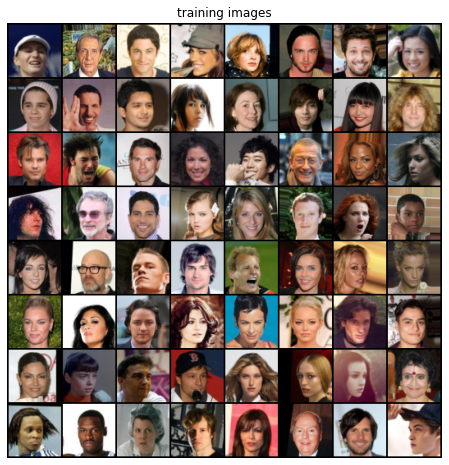

In [10]:
batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("training images")
plt.imshow(np.transpose(vutils.make_grid(batch[0].to(device)[:64], 
                                         padding=2,
                                         normalize=True).cpu(),(1,2,0)))

### Weight Initialization
From the `DCGAN` paper authours specify that model weights must be randomly initialized from a Normal Distribution with mean 0 and standard deviation 0.02.
 
The weights_init function takes an initialized model as input and reinitializes all convolutional, convolutional-transpose, and batch normalization layers to meet this criteria. This function is applied to the models immediately after initialization.

In [11]:
def weight_init(m):
  classname = m.__class__.__name__
  if classname.find('Conv') != -1:
    nn.init.normal_(m.weight.data, 0.0, 0.02)
  elif classname.find('BatchNorm') != -1:
    nn.init.normal_(m.weight.data, 1.0, 0.02)
    nn.init.constant_(m.bias.data, 0)

### Generator Model

The generator, $G$ is designed to map a lated space vector $z$ to an RGB image of size `3x64x64`. This is achived through a series of strided two dimentional convulutional transpose layers each paired with a 2D batch norm layer with relu activation function. The output of the generator is fed through a tanh function to return it to the input data range of $[-1,1]$. The following image shows the structure of a generator from the DCGAN paper:

<img width="100%" src="https://pytorch.org/tutorials/_images/dcgan_generator.png" alt="dcgan"/>


### Code

In [12]:
# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64


In [13]:
class Generator(nn.Module):
  def __init__(self, ngpu):
    super(Generator, self).__init__()
    self.ngpu = ngpu
    self.main = nn.Sequential(
        nn.ConvTranspose2d(LATENT_DIM, ngf * 8, 4, 1, 0, bias=False),
        nn.BatchNorm2d(ngf * 8),
        nn.ReLU(True), # state size. (64*8) x 4 x 4
        nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ngf * 4),
        nn.ReLU(True), # state size. (64*4) x 8 x 8
        nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ngf * 2),
        nn.ReLU(True), # state size. (64*2) x 16 x 16
        nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
        nn.BatchNorm2d(ngf),
        nn.ReLU(True), # state size. (64) x 32 x 32
        nn.ConvTranspose2d(ngf, 3, 4, 2, 1, bias=False),
        nn.Tanh() # state size. (nc) x 64 x 64
    )

  def forward(self, x):
    return self.main(x)

### Creating an instance of a generator.

In [14]:
generator = Generator(1).to(device)

### Initializing the generator weights

We are then going to initialize the weights of the generator with mean = 0 and std = 0.02

In [15]:
generator.apply(weight_init)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

### Helper function for counting model parameters.

In [16]:
def count_trainable_params(model):
  return sum(p.numel() for p in model.parameters()), sum(p.numel() for p in model.parameters() if p.requires_grad)

### Counting the model Parameters of the generator.

In [17]:
n_params, trainable_params = count_trainable_params(generator)
print(f"Total number of paramaters: {n_params:,}\nTotal tainable parameters: {trainable_params:,}")


Total number of paramaters: 3,576,704
Total tainable parameters: 3,576,704


### Generating a fakes image before training.

In [18]:
z = torch.randn(1, LATENT_DIM, 1, 1, device=device)
image = generator(z)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


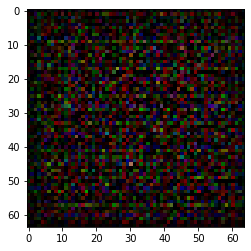

In [19]:
plt.imshow(np.transpose(image[0].cpu().detach().numpy()))
plt.show()

### Discriminator 

The job of the discriminator is to classify weather the image generated by the generator is either real or fake. The discriminator will do the basic binary classification. $D$ takes in an image of size `3x64x64` and processes it through a series of Conv2d, BatchNorm2d, and LeakyReLU layers, and outputs the final probability through a Sigmoid activation function.  

> The `DCGAN` paper mentions it is a good practice to use strided convolution rather than pooling to downsample because it lets the network learn its own pooling function. Also batch norm and leaky relu functions promote healthy gradient flow which is critical for the learning process of both $G$ and $D$.


### Code

In [20]:
class Discriminator(nn.Module):
  def __init__(self, ngpu=1):
    super(Discriminator, self).__init__()
    self.ngpu = ngpu

    self.main = nn.Sequential(
       # input is 3 x 64 x 64 
       nn.Conv2d(3, ndf, 4, 2, 1, bias=False),
       nn.LeakyReLU(0.2, inplace=True),
       # state size. (ndf) x 32 x 32
       nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
       nn.BatchNorm2d(ndf * 2),
       nn.LeakyReLU(0.2, inplace=True),
       # state size. (ndf*2) x 16 x 16
       nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
       nn.BatchNorm2d(ndf * 4),
       nn.LeakyReLU(0.2, inplace=True),
       # state size. (ndf*4) x 8 x 8
       nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
       nn.BatchNorm2d(ndf * 8),
       nn.LeakyReLU(0.2, inplace=True),
       # state size. (ndf*8) x 4 x 4
       nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
       nn.Sigmoid()
    )
  
  def forward(self, x):
    return self.main(x)
    

### Creating the instance of a Discriminator model

In [21]:
discriminator = Discriminator().to(device)

### Applying the weights to the discriminator.

Again like what we did on the generator we are going to apply the weights to the discriminator.

In [22]:
discriminator.apply(weight_init)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

### Counting the parameters of the discriminator model

In [23]:
n_params, trainable_params = count_trainable_params(discriminator)
print(f"Total number of paramaters: {n_params:,}\nTotal tainable parameters: {trainable_params:,}")


Total number of paramaters: 2,765,568
Total tainable parameters: 2,765,568


### Testing the discriminator before training

In [24]:
pred = discriminator(image)
pred

tensor([[[[0.5148]]]], device='cuda:0', grad_fn=<SigmoidBackward0>)

### Losses and Optimizers
With $D$ and $G$ setup, we can specify how they learn
through the loss functions and optimizers. We will use the Binary Cross
Entropy loss
[BCELoss](https://pytorch.org/docs/stable/nn.html#torch.nn.BCELoss>)
function which is defined in PyTorch as:

\begin{align}\ell(x, y) = L = \{l_1,\dots,l_N\}^\top, \quad l_n = - \left[ y_n \cdot \log x_n + (1 - y_n) \cdot \log (1 - x_n) \right]\end{align}

Notice how this function provides the calculation of both log components
in the objective function (i.e. $log(D(x))$ and
$log(1-D(G(z)))$). We can specify what part of the BCE equation to
use with the $y$ input. This is accomplished in the training loop
which is coming up soon, but it is important to understand how we can
choose which component we wish to calculate just by changing $y$
(i.e. GT labels).

Next, we define our real label as 1 and the fake label as 0. These
labels will be used when calculating the losses of $D$ and
$G$, and this is also the convention used in the original GAN
paper. Finally, we set up two separate optimizers, one for $D$ and
one for $G$. As specified in the DCGAN paper, both are Adam
optimizers with learning rate 0.0002 and Beta1 = 0.5. For keeping track
of the generator’s learning progression, we will generate a fixed batch
of latent vectors that are drawn from a Gaussian distribution
(i.e. fixed_noise) . In the training loop, we will periodically input
this fixed_noise into $G$, and over the iterations we will see
images form out of the noise.

In [25]:
criterion = nn.BCELoss().to(device)
fixed_noise = torch.randn(64, LATENT_DIM, 1, 1, device=device)

# labels
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = torch.optim.Adam(discriminator.parameters(), lr=LR, betas=(BETA, 0.999))
optimizerG = torch.optim.Adam(generator.parameters(), lr=LR, betas=(BETA, 0.999))


#### Training


1. Discriminator

Recall, the goal of training the discriminator is to maximize the
probability of correctly classifying a given input as real or fake. In
terms of Goodfellow, we wish to “update the discriminator by ascending
its stochastic gradient”. Practically, we want to maximize
$log(D(x)) + log(1-D(G(z)))$. Due to the separate mini-batch
suggestion from ganhacks, we will calculate this in two steps. First, we
will construct a batch of real samples from the training set, forward
pass through $D$, calculate the loss ($log(D(x))$), then
calculate the gradients in a backward pass. Secondly, we will construct
a batch of fake samples with the current generator, forward pass this
batch through $D$, calculate the loss ($log(1-D(G(z)))$),
and *accumulate* the gradients with a backward pass. Now, with the
gradients accumulated from both the all-real and all-fake batches, we
call a step of the Discriminator’s optimizer.

2. Generator

As stated in the original paper, we want to train the Generator by
minimizing $log(1-D(G(z)))$ in an effort to generate better fakes.
As mentioned, this was shown by Goodfellow to not provide sufficient
gradients, especially early in the learning process. As a fix, we
instead wish to maximize $log(D(G(z)))$. In the code we accomplish
this by: classifying the Generator output from Part 1 with the
Discriminator, computing G’s loss *using real labels as GT*, computing
G’s gradients in a backward pass, and finally updating G’s parameters
with an optimizer step. It may seem counter-intuitive to use the real
labels as GT labels for the loss function, but this allows us to use the
$log(x)$ part of the BCELoss (rather than the $log(1-x)$
part) which is exactly what we want.

Finally, we will do some statistic reporting and at the end of each
epoch we will push our fixed_noise batch through the generator to
visually track the progress of G’s training. The training statistics
reported are:

-  **Loss_D** - discriminator loss calculated as the sum of losses for
   the all real and all fake batches ($log(D(x)) + log(1 - D(G(z)))$).
-  **Loss_G** - generator loss calculated as $log(D(G(z)))$
-  **D(x)** - the average output (across the batch) of the discriminator
   for the all real batch. This should start close to 1 then
   theoretically converge to 0.5 when G gets better. Think about why
   this is.
-  **D(G(z))** - average discriminator outputs for the all fake batch.
   The first number is before D is updated and the second number is
   after D is updated. These numbers should start near 0 and converge to
   0.5 as G gets better. Think about why this is.

**Note:** This step might take a while, depending on how many epochs you
run and if you removed some data from the dataset.




In [26]:
img_list = []
G_losses = []
D_losses = []
iters = 0

NUM_EPOCHS = 10

print("Starting Training Loop...")
for epoch in range(NUM_EPOCHS):
  for i, data in enumerate(dataloader, 0):
    """
    (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    """
    discriminator.zero_grad()
    real_cpu = data[0].to(device)
    b_size = real_cpu.size(0)
    label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
    # Forward pass real batch through D
    output = discriminator(real_cpu).view(-1)
    # Calculate loss on all-real batch
    errD_real = criterion(output, label)
    # Calculate gradients for D in backward pass
    errD_real.backward()
    D_x = output.mean().item()

    ## Train with all-fake batch
    # Generate batch of latent vectors
    noise = torch.randn(b_size, LATENT_DIM, 1, 1, device=device)
    # Generate fake image batch with G
    fake = generator(noise)
    label.fill_(fake_label)
    # Classify all fake batch with D
    output = discriminator(fake.detach()).view(-1)
    # Calculate D's loss on the all-fake batch
    errD_fake = criterion(output, label)
    # Calculate the gradients for this batch, accumulated (summed) with previous gradients
    errD_fake.backward()
    D_G_z1 = output.mean().item()
    # Compute error of D as sum over the fake and the real batches
    errD = errD_real + errD_fake
    # Update D
    optimizerD.step()
    """
    (2) Update G network: maximize log(D(G(z)))
    """
    generator.zero_grad()
    label.fill_(real_label)  # fake labels are real for generator cost
    # Since we just updated D, perform another forward pass of all-fake batch through D
    output = discriminator(fake).view(-1)
    # Calculate G's loss based on this output
    errG = criterion(output, label)
    # Calculate gradients for G
    errG.backward()
    D_G_z2 = output.mean().item()
    # Update G
    optimizerG.step()

    # Output training stats
    if i % 50 == 0:
      print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
            % (epoch, NUM_EPOCHS, i, len(dataloader),
                errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

    # Save Losses for plotting later
    G_losses.append(errG.item())
    D_losses.append(errD.item())

    # Check how the generator is doing by saving G's output on fixed_noise
    if (iters % 500 == 0) or ((epoch == NUM_EPOCHS-1) and (i == len(dataloader)-1)):
      with torch.no_grad():
          fake = generator(fixed_noise).detach().cpu()
      img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

    iters += 1


Starting Training Loop...
[0/10][0/1583]	Loss_D: 1.5809	Loss_G: 6.1968	D(x): 0.6596	D(G(z)): 0.6094 / 0.0032
[0/10][50/1583]	Loss_D: 0.0847	Loss_G: 9.7444	D(x): 0.9473	D(G(z)): 0.0004 / 0.0002
[0/10][100/1583]	Loss_D: 0.2020	Loss_G: 8.6659	D(x): 0.8843	D(G(z)): 0.0064 / 0.0004
[0/10][150/1583]	Loss_D: 0.3126	Loss_G: 3.6377	D(x): 0.8469	D(G(z)): 0.0656 / 0.0469
[0/10][200/1583]	Loss_D: 0.2951	Loss_G: 4.9360	D(x): 0.8462	D(G(z)): 0.0771 / 0.0175
[0/10][250/1583]	Loss_D: 0.5672	Loss_G: 5.0996	D(x): 0.7388	D(G(z)): 0.0973 / 0.0161
[0/10][300/1583]	Loss_D: 0.3677	Loss_G: 2.8810	D(x): 0.7609	D(G(z)): 0.0391 / 0.0911
[0/10][350/1583]	Loss_D: 0.6008	Loss_G: 4.9858	D(x): 0.9089	D(G(z)): 0.3485 / 0.0181
[0/10][400/1583]	Loss_D: 0.4571	Loss_G: 4.3984	D(x): 0.9385	D(G(z)): 0.2817 / 0.0257
[0/10][450/1583]	Loss_D: 0.8810	Loss_G: 5.9961	D(x): 0.8918	D(G(z)): 0.4513 / 0.0069
[0/10][500/1583]	Loss_D: 0.4995	Loss_G: 3.6954	D(x): 0.8770	D(G(z)): 0.2211 / 0.0411
[0/10][550/1583]	Loss_D: 0.5489	Loss_G: 3.

### Results


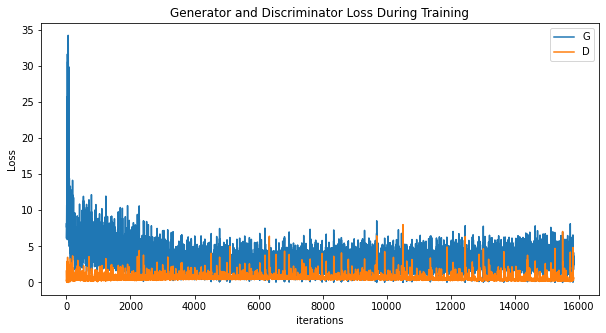

In [27]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

### Visualization of G’s progression

The following code shows the generator's progression during training

In [28]:
from IPython.display import HTML
import matplotlib.animation as animation

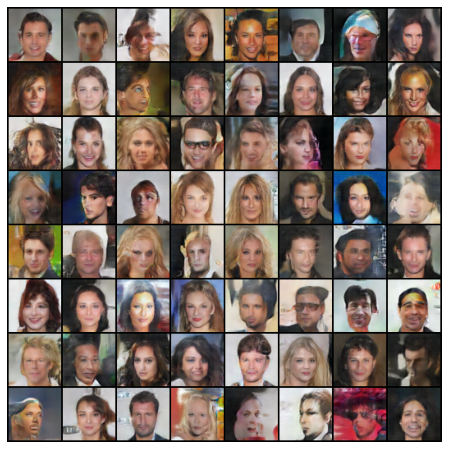

In [29]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

### Real Images vs Fake Images

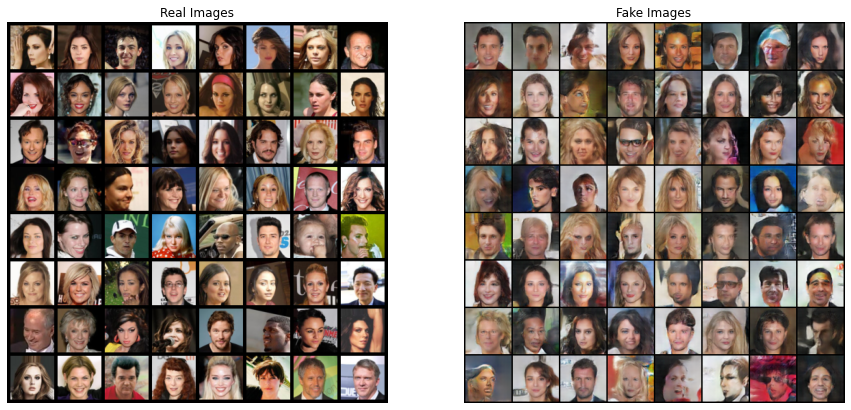

In [30]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

### Model inference

In [44]:
noise = torch.randn(1, LATENT_DIM, 1, 1, device=device)
fake_img = generator(noise)

In [33]:
def normalize_image(image):
    image_min = image.min()
    image_max = image.max()
    image.clamp_(min = image_min, max = image_max)
    image.add_(-image_min).div_(image_max - image_min + 1e-5)
    return image

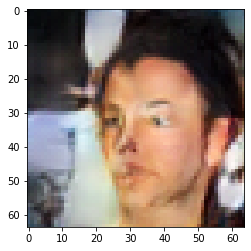

In [45]:
img = normalize_image(fake_img[0].permute(1, 2, 0).cpu().detach())
plt.imshow(img.numpy())
plt.show()

### Ref

1. [pytorch.org/tutorials](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)